In [9]:
library(ggplot2)
library(ggpubr)
library(viridis)
library(gridExtra)
library(dplyr)
library(data.table)
library(magrittr)
library(ggpubr)
library(harmony)
library(Rtsne)

In [10]:
inPath = "/graph_rdata/"
methodList = c('CellScale','BandScale', 'BandNorm', 'scHiCluster', 'scHiC Topics', 'Higashi', 'BandScale+CNN', 'scVI-3D')

set.seed(1234)
generate_series_tsne = function(res_tsne, label, title, dataset){
    
    plot_list = list()
    if(dataset == "Ramani2017"){
        plot_list[["celltype"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$cell_type) %>% ggplot(aes(X1, X2, color = label)) +
        geom_point() +
        theme_bw(base_size = 25) +
        scale_color_viridis(discrete = TRUE) +
        theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
        ggtitle(title)
    }
    if(dataset == "Kim2020"){
        plot_list[["celltype"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$cell_type) %>% ggplot(aes(X1, X2, color = label)) +
        geom_point() +
        theme_bw(base_size = 25) +
        scale_color_viridis(discrete = TRUE, option = "magma") +
        theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
        ggtitle(title)
    }
    if(dataset == "Lee2019"){
        plot_list[["celltype"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$cell_type) %>% ggplot(aes(X1, X2, color = label)) +
        geom_point() +
        theme_bw(base_size = 25) +
        scale_color_manual(breaks = c("Astro", "Endo", "L23", "L4", 'L5', 'L6', 'MG', 'MP', 'Ndnf', 'ODC', 'OPC', 'Pvalb', 'Sst', 'Vip'),
                  values = c("dodgerblue2", "#E31A1C", "green4", "#6A3D9A", "#FF7F00", "black", "gold1", "skyblue2", "palegreen2", "#FDBF6F", "gray70", "maroon", "orchid1", "darkturquoise")) +
        theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
        ggtitle(title)
    }
    if(dataset == "Li2019"){
        plot_list[["celltype"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$cell_type) %>% ggplot(aes(X1, X2, color = label)) +
        geom_point() +
        theme_bw(base_size = 25) +
        scale_color_viridis(option="inferno", discrete = TRUE, begin = 0, end = 0.8) 
        theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
        ggtitle(title)
    }
    plot_list[["batch"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$batch) %>% ggplot(aes(X1, X2, color = label)) +
    geom_point() +
    theme_bw(base_size = 25) +
    scale_color_viridis(discrete = TRUE, option = "plasma") +
    theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
    ggtitle(title)

    plot_list[["seqD"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$depth) %>% ggplot(aes(X1, X2, color = label)) +
    geom_point() +
    theme_bw(base_size = 25) +
    scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000,100000, 1000000)) +
    theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
    ggtitle(title)
    
    plot_list[["sparsity"]] = data.frame(X1 = res_tsne$X1, X2 = res_tsne$X2, label = label$sparsity) %>% ggplot(aes(X1, X2, color = label)) +
    geom_point() +
    theme_bw(base_size = 25) +
    scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(2000, 3000, 5000, 8000, 15000, 30000, 60000)) +
    theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + ggpubr::rremove("legend")  +
    ggtitle(title)
    
    return(plot_list)

}

In [11]:
## Ramani2017
## Ramani2017
Ramani = list(methodList)
for(method in methodList){
    Ramani[[method]] = vector("list", 8)
}
load(paste0(inPath, "ramani_bandnorm_base.Rdata"))
method = "CellScale"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


load(paste0(inPath, "ramani_bandnorm_mean.Rdata"))
method = "BandScale"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ramani_bandnorm_removebatch.Rdata"))
method = "BandNorm"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


load(paste0(inPath, "ramani_schicluster.Rdata"))
method = "scHiCluster"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ramani_cistopic.Rdata"))
method = "scHiC Topics"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ramani_higashi.Rdata"))
method = "Higashi"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ramani_cnn_mean.Rdata"))
method = "BandScale+CNN"
Ramani[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


cols = c("dodgerblue2", "#E31A1C", "green4", "#6A3D9A", "#FF7F00",
         "black", "gold1", "skyblue2", "palegreen2", "#FDBF6F",
         "gray70", "maroon", "orchid1", "darkturquoise", "darkorange4",
         "brown")

load(paste0(inPath, "Ramani2017_3DVI_fig_band0.9_imputeLatent0.RData"))
method = "scVI-3D"
Ramani[[method]][[1]] = mPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="viridis", discrete = TRUE) + scale_fill_manual(values=cols) + theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[2]] = mPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[3]] = mPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000, 50000, 200000, 500000))
Ramani[[method]][[4]] = mPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(2000, 3000, 5000, 8000, 15000, 30000, 60000))
Ramani[[method]][[5]] = tPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="viridis", discrete = TRUE) + scale_fill_manual(values=cols) + theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[6]] = tPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Ramani[[method]][[7]] = tPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000, 50000, 200000, 500000))
Ramani[[method]][[8]] = tPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(2000, 3000, 5000, 8000, 15000, 30000, 60000))


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



png 
  2

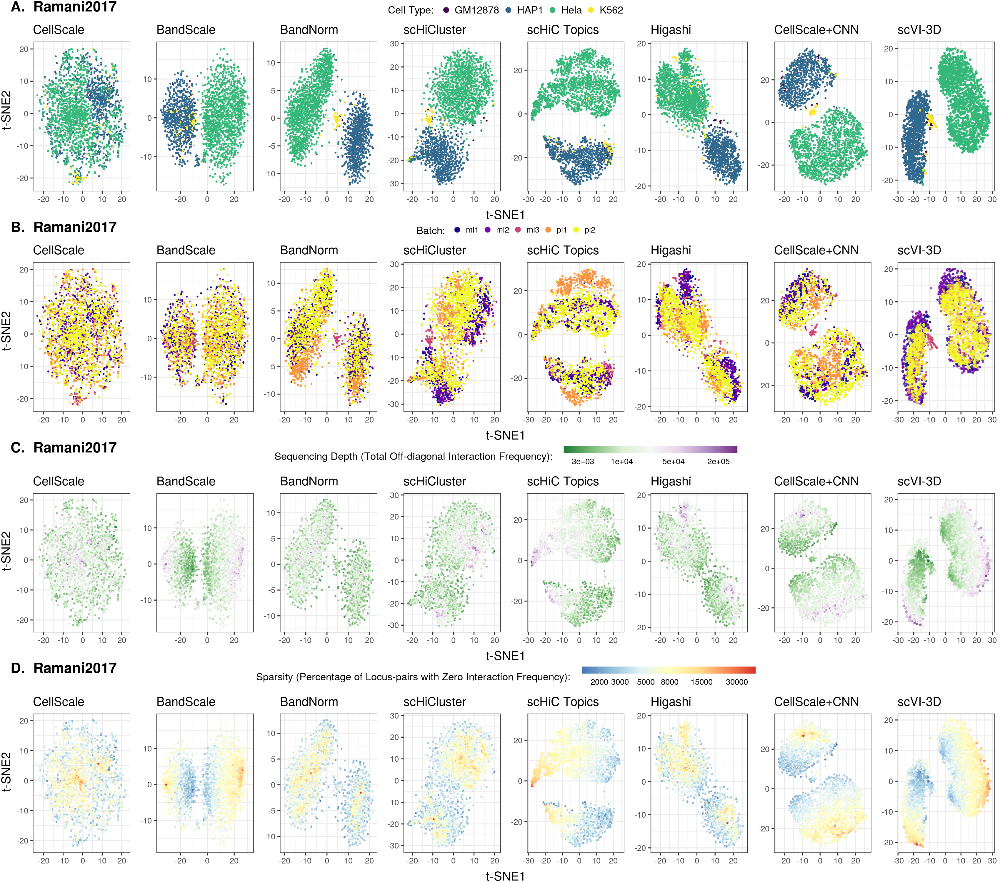

In [16]:
options(repr.plot.width = 34, repr.plot.height = 30, repr.plot.res = 100)
ind = 5
sup5A = ggarrange(Ramani[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Ramani[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Ramani[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_ramani[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_ramani[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_ramani[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top") 


sup5A = annotate_figure(sup5A,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "A.  Ramani2017", fig.lab.face = "bold", fig.lab.size = 35)

ind = 6
sup5B = ggarrange(Ramani[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + guides(colour = guide_legend(title = "Batch: ", nrow = 1, override.aes = list(size = 6))), 
                  Ramani[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Ramani[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_ramani[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_ramani[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_ramani[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top")
                  


sup5B = annotate_figure(sup5B,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "B.  Ramani2017", fig.lab.face = "bold", fig.lab.size = 35)

ind = 7
sup5C = ggarrange(Ramani[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Ramani[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Ramani[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_ramani[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_ramani[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_ramani[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE,
                  legend.grob = get_legend(Ramani[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sequencing Depth (Total Off-diagonal Interaction Frequency): "))), legend = "top") 
 

sup5C = annotate_figure(sup5C,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "C.  Ramani2017", fig.lab.face = "bold", fig.lab.size = 35)

ind = 8
sup5D = ggarrange(Ramani[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Ramani[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Ramani[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_ramani[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_ramani[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Ramani[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_ramani[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Ramani[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, 
                  legend.grob = get_legend(Ramani[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sparsity (Percentage of Locus-pairs with Zero Interaction Frequency): "))), legend = "top")


sup5D = annotate_figure(sup5D,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "D.  Ramani2017", fig.lab.face = "bold", fig.lab.size = 35)

ggarrange(sup5A, sup5B, sup5C, sup5D, nrow = 4, ncol = 1)

pdf("/p/keles/schic/volumeA/ReviseFigures/Ramani_tsne.pdf", width = 34, height =30)
ggarrange(sup5A, sup5B, sup5C, sup5D, nrow = 4, ncol = 1)
dev.off()


In [12]:
inPath = "/graph_rdata/"
methodList = c('CellScale','BandScale', 'BandNorm', 'scHiCluster', 'scHiC Topics', 'Higashi', 'BandScale+CNN', 'scVI-3D')

## Kim2020
Kim = list(methodList)
for(method in methodList){
    Kim[[method]] = vector("list", 8)
}
load(paste0(inPath, "kim_bandnorm_base.Rdata"))
method = "CellScale"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")


load(paste0(inPath, "kim_bandnorm_mean.Rdata"))
method = "BandScale"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")

load(paste0(inPath, "Kim2020_BandNorm_fig.RData"))
method = "BandNorm"
Kim[[method]][[1]] = mPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="magma", discrete = TRUE) + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[2]] = mPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[3]] = mPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000,100000, 1000000))
Kim[[method]][[4]] = mPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(1000, 3000, 5000, 8000, 15000, 30000, 60000))
Kim[[method]][[5]] = tPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="magma", discrete = TRUE) + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[6]] = tPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[7]] = tPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000,100000, 1000000))
Kim[[method]][[8]] = tPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(1000, 3000, 5000, 8000, 15000, 30000, 60000))


load(paste0(inPath, "kim_schicluster.Rdata"))
method = "scHiCluster"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")

load(paste0(inPath, "kim_cistopic.Rdata"))
method = "scHiC Topics"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")

load(paste0(inPath, "kim_higashi.Rdata"))
method = "Higashi"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")

load(paste0(inPath, "kim_cnn_mean.Rdata"))
method = "BandScale+CNN"
Kim[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")
Kim[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25)  + xlab("") + ylab("")


load(paste0(inPath, "Kim2020_3DVI_fig.RData"))
method = "scVI-3D"
Kim[[method]][[1]] = mPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="magma", discrete = TRUE) + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[2]] = mPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[3]] = mPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000,100000, 1000000))
Kim[[method]][[4]] = mPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(1000, 3000, 5000, 8000, 15000, 30000, 60000))
Kim[[method]][[5]] = tPlot[["cell"]] + ggtitle(method) + scale_color_viridis(option="magma", discrete = TRUE) + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[6]] = tPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Kim[[method]][[7]] = tPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(3000, 10000,100000, 1000000))
Kim[[method]][[8]] = tPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(1000, 3000, 5000, 8000, 15000, 30000, 60000))


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

[1] 9230   20

[1] "GM12878" "H1Esc"   "HAP1"    "HFF"     "IMR90"

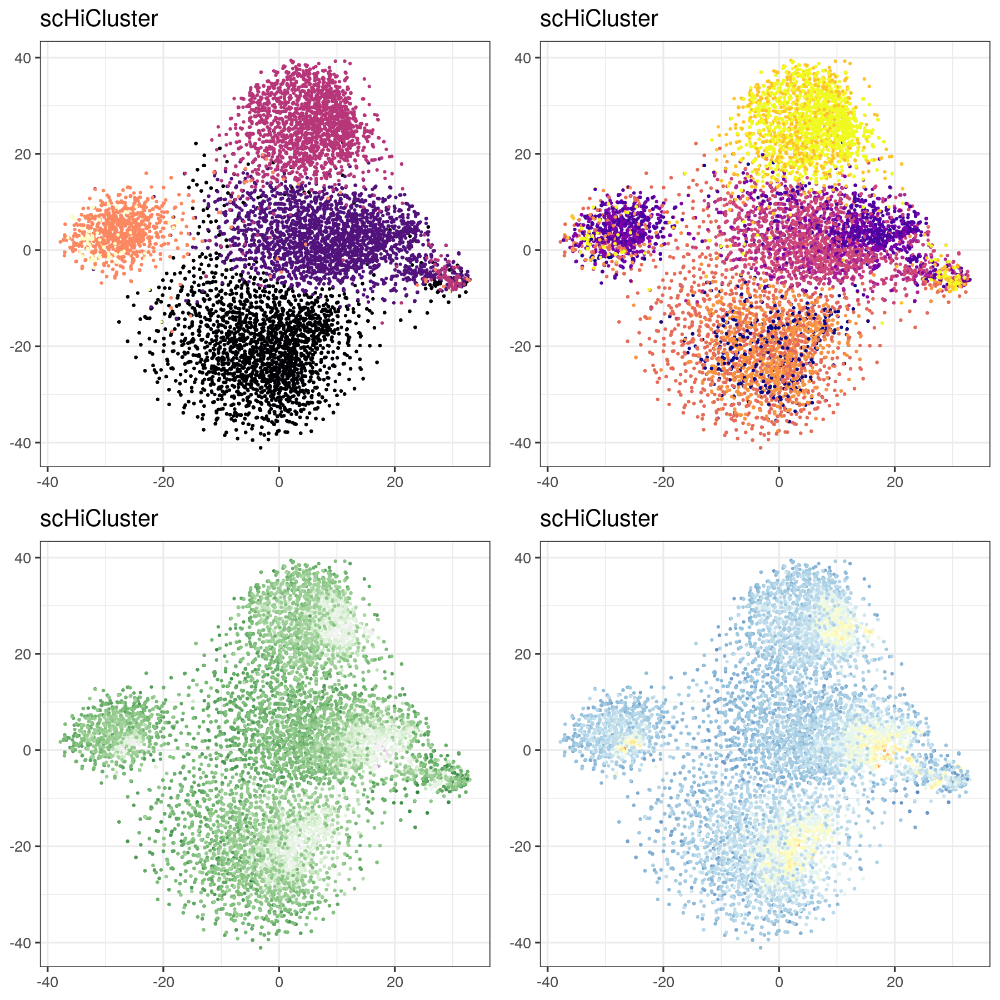

In [13]:
## schicluster update
options(repr.plot.width = 18, repr.plot.height = 18, repr.plot.res = 100)
embed = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/embeddings/Kim2020_schicluster.csv")
dim(embed)
label = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/summaryFiles/Kim2020_summary.txt", header = T)
label$cell_type %>% unique

res_tsne = Rtsne(embed)$Y %>% data.frame
schicluster_kim = generate_series_tsne(res_tsne, label, "scHiCluster", "Kim2020")

ggarrange(schicluster_kim[["celltype"]], schicluster_kim[["batch"]], schicluster_kim[["seqD"]], schicluster_kim[["sparsity"]], nrow = 2, ncol = 2)


[1] 9230   64

[1] "GM12878" "H1Esc"   "HAP1"    "HFF"     "IMR90"

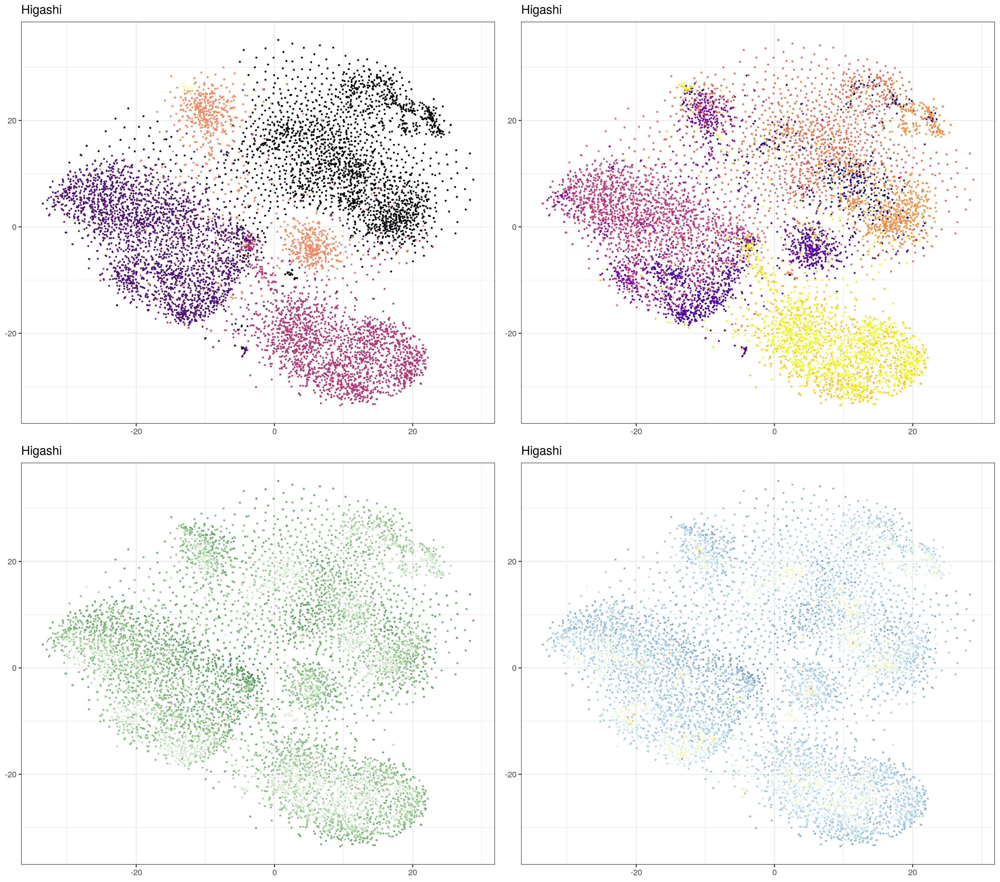

In [24]:
#higashi update
embed = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/embeddings/Kim2020_higashi.csv")
dim(embed)

label = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/summaryFiles/Kim2020_summary.txt", header = T)
label$cell_type %>% unique
res_tsne = Rtsne(embed)$Y %>% data.frame

higashi_kim = generate_series_tsne(res_tsne, label, "Higashi", "Kim2020")

ggarrange(higashi_kim[["celltype"]], higashi_kim[["batch"]], higashi_kim[["seqD"]], higashi_kim[["sparsity"]], nrow = 2, ncol = 2)



[1] 9230   20

[1] "GM12878" "H1Esc"   "HAP1"    "HFF"     "IMR90"

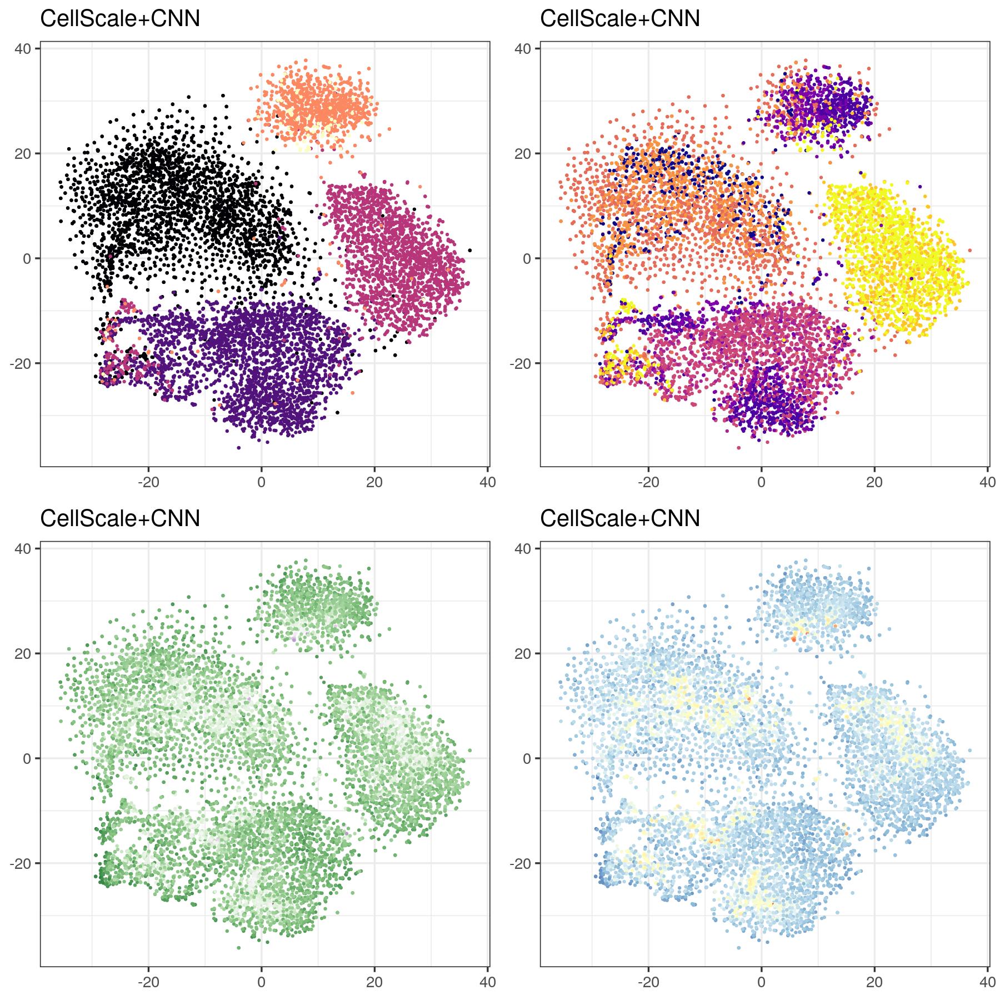

In [15]:
## CNN update
embed = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/embeddings/Kim2020_CNNcellscale.csv")
dim(embed)
label = fread("/p/keles/schic/volumeC/SiqiShen/code/BandNormPaper/paper_prep/01072022/summaryFiles/Kim2020_summary.txt", header = T)
label$cell_type %>% unique

res_tsne = Rtsne(embed)$Y %>% data.frame
cnn_kim = generate_series_tsne(res_tsne, label, "CellScale+CNN", "Kim2020")

ggarrange(cnn_kim[["celltype"]], cnn_kim[["batch"]], cnn_kim[["seqD"]], cnn_kim[["sparsity"]], nrow = 2, ncol = 2)


png 
  2

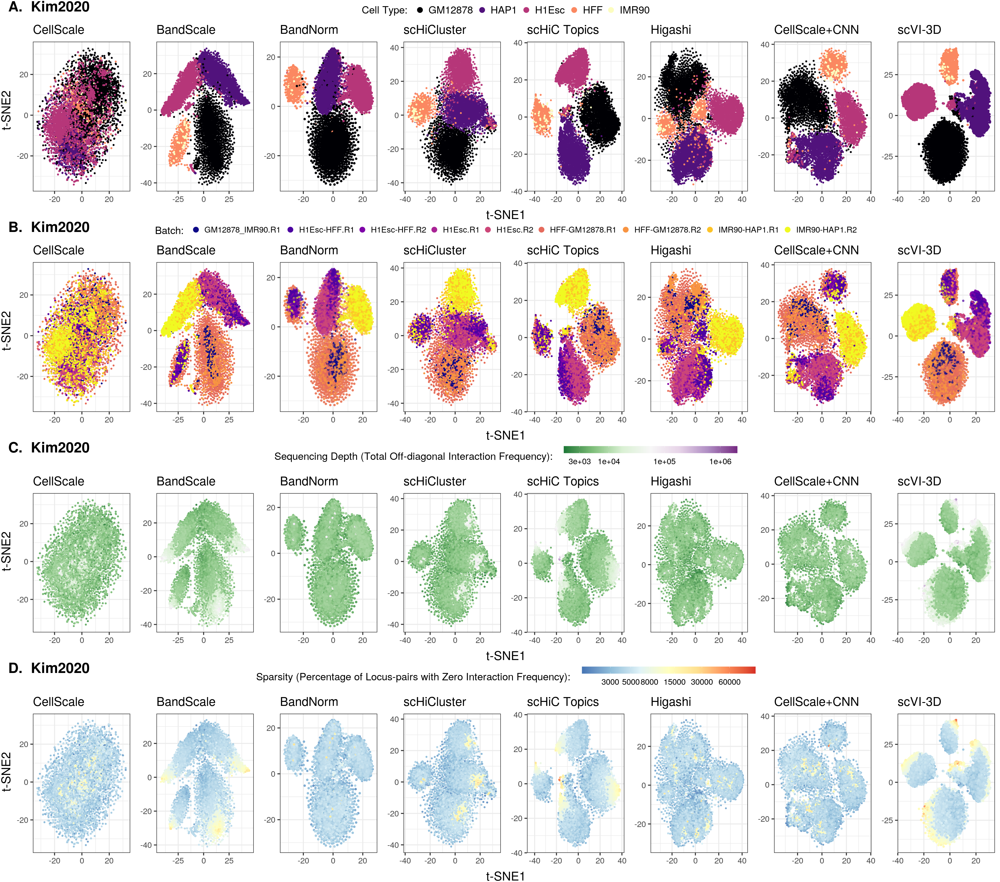

In [16]:
options(repr.plot.width = 34, repr.plot.height = 30, repr.plot.res = 100)
ind = 5
sup7A = ggarrange(Kim[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Kim[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Kim[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_kim[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_kim[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_kim[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top") 


sup7A = annotate_figure(sup7A,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "A.  Kim2020", fig.lab.face = "bold", fig.lab.size = 35)

ind = 6
sup7B = ggarrange(Kim[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + guides(colour = guide_legend(title = "Batch: ", nrow = 1, override.aes = list(size = 6))), 
                  Kim[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Kim[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_kim[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_kim[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_kim[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top")
                  


sup7B = annotate_figure(sup7B,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "B.  Kim2020", fig.lab.face = "bold", fig.lab.size = 35)

ind = 7
sup7C = ggarrange(Kim[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Kim[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Kim[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_kim[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_kim[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_kim[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE,
                  legend.grob = get_legend(Kim[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sequencing Depth (Total Off-diagonal Interaction Frequency): "))), legend = "top") 
 

sup7C = annotate_figure(sup7C,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "C.  Kim2020", fig.lab.face = "bold", fig.lab.size = 35)

ind = 8
sup7D = ggarrange(Kim[[methodList[1]]][[ind]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  Kim[[methodList[2]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Kim[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_kim[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[5]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_kim[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Kim[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_kim[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  Kim[[methodList[8]]][[ind]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, 
                  legend.grob = get_legend(Kim[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sparsity (Percentage of Locus-pairs with Zero Interaction Frequency): "))), legend = "top")


sup7D = annotate_figure(sup7D,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "D.  Kim2020", fig.lab.face = "bold", fig.lab.size = 35)

ggarrange(sup7A, sup7B, sup7C, sup7D, nrow = 4, ncol = 1)

pdf("/p/keles/schic/volumeA/ReviseFigures/Kim_tsne.pdf", width = 34, height =30)
ggarrange(sup7A, sup7B, sup7C, sup7D, nrow = 4, ncol = 1)
dev.off()


In [25]:
## Lee2019

## Lee2019
cols = c("dodgerblue2", "#E31A1C", "green4", "#6A3D9A", "#FF7F00",
         "black", "gold1", "skyblue2", "palegreen2", "#FDBF6F",
         "gray70", "maroon", "orchid1", "darkturquoise", "darkorange4",
         "brown")

Lee = list(methodList)
for(method in methodList){
    Lee[[method]] = vector("list", 8)
}
load(paste0(inPath, "ecker_bandnorm_base.Rdata"))
method = "CellScale"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


load(paste0(inPath, "ecker_bandnorm_mean.Rdata"))
method = "BandScale"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

## load(paste0(inPath, "ecker_bandnorm.Rdata"))
load(paste0(inPath, "ecker_bandnorm_harmony.Rdata"))
method = "BandNorm"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


load(paste0(inPath, "ecker_schicluster.Rdata"))
method = "scHiCluster"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ecker_cistopic.Rdata"))
method = "scHiC Topics"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ecker_higashi.Rdata"))
method = "Higashi"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")

load(paste0(inPath, "ecker_cnn_mean.Rdata"))
method = "BandScale+CNN"
Lee[[method]][[1]] = p1 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = p2 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = p3 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[4]] = p4 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[5]] = p5 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = p6 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = p7 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[8]] = p8 + ggtitle(method) +theme_bw(base_size = 25) + xlab("") + ylab("")


load(paste0(inPath, "Lee2019_3DVI_fig_rmBatch.RData"))
method = "scVI-3D"
Lee[[method]][[1]] = mPlot[["cell"]] + ggtitle(method) + scale_color_manual(values=cols) + scale_fill_manual(values=cols) + theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[2]] = mPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[3]] = mPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(200000, 400000, 1000000, 2000000))
Lee[[method]][[4]] = mPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("") + scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(8000, 15000, 30000, 60000))
Lee[[method]][[5]] = tPlot[["cell"]] + ggtitle(method) + scale_color_manual(values=cols) + scale_fill_manual(values=cols) + theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[6]] = tPlot[["batch"]] + ggtitle(method) + scale_fill_viridis(option="plasma") + theme_bw(base_size = 25) + xlab("") + ylab("")
Lee[[method]][[7]] = tPlot[["seqDepth"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "PRGn", trans = "log", breaks = c(200000, 400000, 1000000, 2000000))
Lee[[method]][[8]] = tPlot[["sparsity"]] + ggtitle(method) + theme_bw(base_size = 25) + xlab("") + ylab("")+ scale_colour_distiller(palette = "RdYlBu", trans = "log", breaks = c(8000, 15000, 30000, 60000))

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



png 
  2

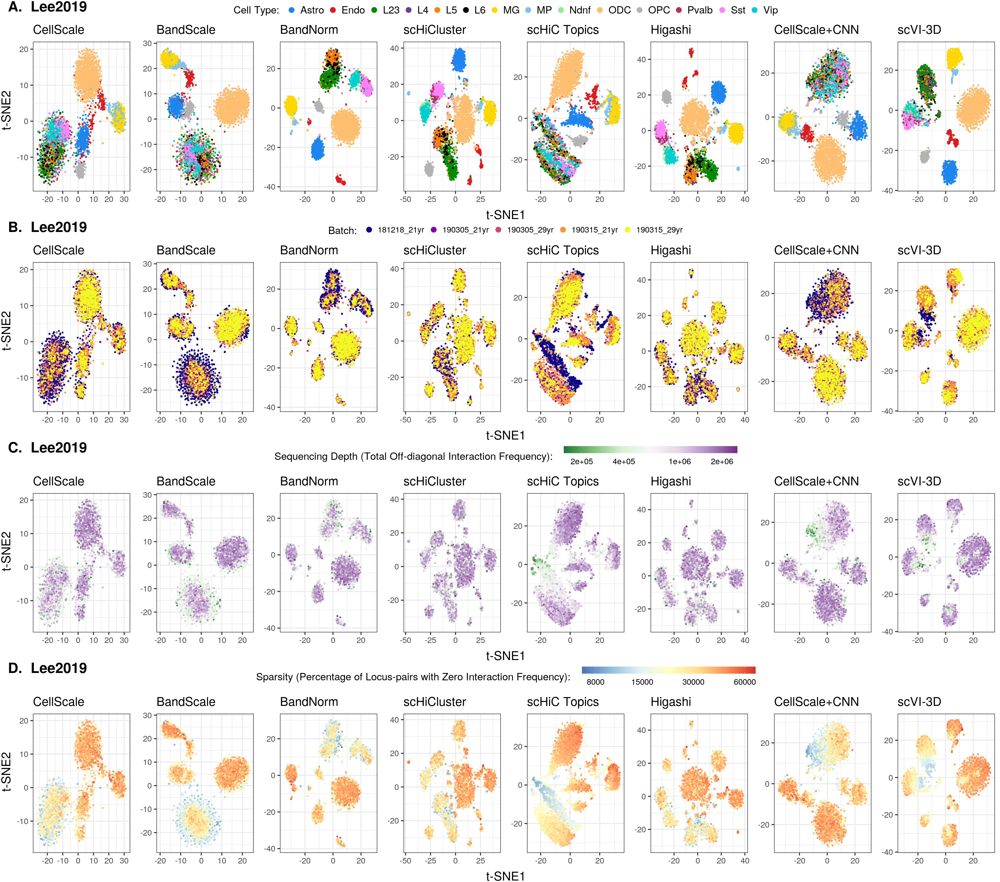

In [73]:
options(repr.plot.width = 34, repr.plot.height = 30, repr.plot.res = 100)
ind = 5
sup6A = ggarrange(cellscale_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  bandscale_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Lee[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cistopic_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_lee[["celltype"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  vi_lee[["celltype"]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top") 


sup6A = annotate_figure(sup6A,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "A.  Lee2019", fig.lab.face = "bold", fig.lab.size = 35)

ind = 6
sup6B = ggarrange(cellscale_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + guides(colour = guide_legend(title = "Batch: ", nrow = 1, override.aes = list(size = 6))), 
                  bandscale_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Lee[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cistopic_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_lee[["batch"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  vi_lee[["batch"]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, legend = "top")
                  


sup6B = annotate_figure(sup6B,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "B.  Lee2019", fig.lab.face = "bold", fig.lab.size = 35)

ind = 7
sup6C = ggarrange(cellscale_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  bandscale_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Lee[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cistopic_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_lee[["seqD"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  vi_lee[["seqD"]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE,
                  legend.grob = get_legend(Lee[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sequencing Depth (Total Off-diagonal Interaction Frequency): "))), legend = "top") 
 

sup6C = annotate_figure(sup6C,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "C.  Lee2019", fig.lab.face = "bold", fig.lab.size = 35)

ind = 8
sup6D = ggarrange(cellscale_lee[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()) + theme(legend.text = element_text(size = 25)) + guides(colour = guide_legend(title = "Cell Type: ", nrow = 1, override.aes = list(size = 6))), 
                  bandscale_lee[["sparsity"]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  Lee[[methodList[3]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[4]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  schicluster_lee[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cistopic_lee[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[6]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  higashi_lee[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  #Lee[[methodList[7]]][[ind]]+  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  cnn_lee[["sparsity"]] +  theme(axis.title.x=element_blank(), axis.title.y=element_blank()),
                  vi_lee[["sparsity"]] + theme(axis.title.x=element_blank(), axis.title.y=element_blank()), 
                  ncol = 8, nrow = 1, common.legend = TRUE, 
                  legend.grob = get_legend(Lee[[methodList[8]]][[ind]]+ theme(legend.position = "top", legend.key.width = unit(3, "cm")) + guides(colour = guide_colourbar(title = "Sparsity (Percentage of Locus-pairs with Zero Interaction Frequency): "))), legend = "top")


sup6D = annotate_figure(sup6D,
                bottom = text_grob("t-SNE1", size = 30),
                left = text_grob("t-SNE2", rot = 90, size = 30),
                fig.lab = "D.  Lee2019", fig.lab.face = "bold", fig.lab.size = 35)

ggarrange(sup6A, sup6B, sup6C, sup6D, nrow = 4, ncol = 1)

pdf("/p/keles/schic/volumeA/ReviseFigures/Lee_tsne.pdf", width = 34, height =30)
ggarrange(sup6A, sup6B, sup6C, sup6D, nrow = 4, ncol = 1)
dev.off()
